In [1]:
import scanpy as sc
import scvelo as scv
%matplotlib inline

import scanpy as sc
import anndata as ad
import scanpy.external as sce
import numpy as np
import seaborn as sb
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import matplotlib
import pandas as pd
#from gprofiler import GProfiler
import os
#import gseapy as gp2
#import scrublet as scr
from scipy.sparse import csr_matrix
from time import time
import celltypist
from celltypist import models

import numpy as np

from scipy.stats import chisquare
from scipy import stats

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages


sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
# settings for the plots
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=250,
                     frameon=True, vector_friendly=True,
                     color_map="YlGnBu", format='pdf', transparent=False,
                     ipython_format='png2x')

def top_marker_as_xlsx(adata, key_rank_genes, key_groups, output_file):
    
    print(adata.uns[key_rank_genes].keys())
    dict_genes = adata.uns[key_rank_genes].copy()
    print(dict_genes['params'])
    tmp = list(set(adata.obs[key_groups]))
    if dict_genes['params']['reference'] != 'rest':
        tmp.remove(dict_genes['params']['reference'])
    print(tmp, type(tmp))
    del dict_genes['params']
    clusters = sorted(tmp)*len(dict_genes['scores'])
    for key, value in dict_genes.items():
        tmp_list = []
        for n in value:
            tmp_list = tmp_list + list(n)
        dict_genes[key] = tmp_list
    
    dict_genes['cluster'] = clusters
    dataframe = pd.DataFrame(dict_genes)
    dataframe.to_excel(output_file)
    return(dataframe)

def top_marker_as_csv(adata, key_rank_genes, key_groups, output_file):
    
    print(adata.uns[key_rank_genes].keys())
    dict_genes = adata.uns[key_rank_genes].copy()
    print(dict_genes['params'])
    tmp = list(set(adata.obs[key_groups]))
    if dict_genes['params']['reference'] != 'rest':
        tmp.remove(dict_genes['params']['reference'])
    print(tmp, type(tmp))
    del dict_genes['params']
    clusters = sorted(tmp)*len(dict_genes['scores'])
    for key, value in dict_genes.items():
        tmp_list = []
        for n in value:
            tmp_list = tmp_list + list(n)
        dict_genes[key] = tmp_list
    
    dict_genes['cluster'] = clusters
    dataframe = pd.DataFrame(dict_genes)
    dataframe.to_csv(output_file)
    return(dataframe)

def make_boxplots(adata, genes, group_by, save=False):
    for curr_gene in genes:
        
        if type(genes) == str:
            genes = [genes]
        # extract the gene of interest
        index = 0
        for gene_name in adata.var_names.tolist():
            if curr_gene in gene_name:
                adata.obs[curr_gene] = adata.X[:,index]#.todense() 
            index += 1
         
        # make the plot
        ax = sns.boxplot(x=group_by, y=curr_gene, data=adata.obs)
        del adata.obs[curr_gene]
        
        # saving the plot
        if save:
            output_file_name = curr_gene+"_boxplot.png"
            output_directory = os.getcwd()+'/figures'
            # create output directory if it doesn't exist
            if not os.path.exists(output_directory):
                os.makedirs(output_directory)
            # save the boxplot
            plt.savefig(os.path.join(output_directory, output_file_name))
            
        # show the plot
        plt.show()
        
def scale_data_5_75(data):
    mind = np.min(data)
    maxd = np.max(data)
    
    if maxd == mind:
        maxd=maxd+1
        mind=mind-1
        
    drange = maxd - mind
    return ((((data - mind)/drange*0.70)+0.05)*100)


def plot_enrich(data, n_terms=20, save=False):
    # Test data input
    if not isinstance(data, pd.DataFrame):
        raise ValueError('Please input a Pandas Dataframe output by gprofiler.')
        
    if not np.all([term in data.columns for term in ['p_value', 'name', 'intersection_size']]):
        raise TypeError('The data frame {} does not contain enrichment results from gprofiler.'.format(data))
    
    data_to_plot = data.iloc[:n_terms,:].copy()
    data_to_plot['go.id'] = data_to_plot.index

    min_pval = data_to_plot['p_value'].min()
    max_pval = data_to_plot['p_value'].max()
    
    # Scale intersection_size to be between 5 and 75 for plotting
    #Note: this is done as calibration was done for values between 5 and 75
    data_to_plot['scaled.overlap'] = scale_data_5_75(data_to_plot['intersection_size'])
    
    norm = colors.LogNorm(min_pval, max_pval)
    sm = plt.cm.ScalarMappable(cmap="cool", norm=norm)
    sm.set_array([])

    rcParams.update({'font.size': 14, 'font.weight': 'bold'})

    sns.set(style="whitegrid")

    path = plt.scatter(x='recall', y="name", c='p_value', cmap='cool', 
                       norm=colors.LogNorm(min_pval, max_pval), 
                       data=data_to_plot, linewidth=1, edgecolor="grey", 
                       s=[(i+10)**1.5 for i in data_to_plot['scaled.overlap']])
    ax = plt.gca()
    ax.invert_yaxis()

    ax.set_ylabel('')
    ax.set_xlabel('Gene ratio', fontsize=14, fontweight='bold')
    ax.xaxis.grid(False)
    ax.yaxis.grid(True)

    # Shrink current axis by 20%
    box = ax.get_position()
    ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])

    # Get tick marks for this plot
    #Note: 6 ticks maximum
    min_tick = np.floor(np.log10(min_pval)).astype(int)
    max_tick = np.ceil(np.log10(max_pval)).astype(int)
    tick_step = np.ceil((max_tick - min_tick)/6).astype(int)
    
    # Ensure no 0 values
    if tick_step == 0:
        tick_step = 1
        min_tick = max_tick-1
    
    ticks_vals = [10**i for i in range(max_tick, min_tick-1, -tick_step)]
    ticks_labs = ['$10^{'+str(i)+'}$' for i in range(max_tick, min_tick-1, -tick_step)]

    #Colorbar
    fig = plt.gcf()
    cbaxes = fig.add_axes([0.8, 0.15, 0.03, 0.4])
    cbar = ax.figure.colorbar(sm, ticks=ticks_vals, shrink=0.5, anchor=(0,0.1), cax=cbaxes)
    cbar.ax.set_yticklabels(ticks_labs)
    cbar.set_label("Adjusted p-value", fontsize=14, fontweight='bold')

    #Size legend
    min_olap = data_to_plot['intersection_size'].min()
    max_olap = data_to_plot['intersection_size'].max()
    olap_range = max_olap - min_olap
    
    #Note: approximate scaled 5, 25, 50, 75 values are calculated
    #      and then rounded to nearest number divisible by 5
    size_leg_vals = [np.round(i/5)*5 for i in 
                          [min_olap, min_olap+(20/70)*olap_range, min_olap+(45/70)*olap_range, max_olap]]
    size_leg_scaled_vals = scale_data_5_75(size_leg_vals)

    
    l1 = plt.scatter([],[], s=(size_leg_scaled_vals[0]+10)**1.5, edgecolors='none', color='black')
    l2 = plt.scatter([],[], s=(size_leg_scaled_vals[1]+10)**1.5, edgecolors='none', color='black')
    l3 = plt.scatter([],[], s=(size_leg_scaled_vals[2]+10)**1.5, edgecolors='none', color='black')
    l4 = plt.scatter([],[], s=(size_leg_scaled_vals[3]+10)**1.5, edgecolors='none', color='black')

    labels = [str(int(i)) for i in size_leg_vals]

    leg = plt.legend([l1, l2, l3, l4], labels, ncol=1, frameon=False, fontsize=12,
                     handlelength=1, loc = 'center left', borderpad = 1, labelspacing = 1.4,
                     handletextpad=2, title='Gene overlap', scatterpoints = 1,  bbox_to_anchor=(0.1, 1.5), 
                     facecolor='black')

    if save:
        plt.savefig(save, dpi=300, format='pdf', bbox_inches="tight")

    plt.show()

2023-07-09 11:07:23.234614: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-09 11:07:23.411053: I tensorflow/core/util/port.cc:104] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-07-09 11:07:23.440180: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2023-07-09 11:07:23.440209: I tensorflow/compiler/xla/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudar

# Load data

In [2]:
adata = sc.read('tmp_processing_correct_unitvelo2.h5ad')
adata

AnnData object with n_obs × n_vars = 65587 × 1880
    obs: 'sample', 'cell_barcode_sample', 'full_label', 'timepoint', 'doublet_score', 'predicted_doublet', 'n_counts', 'log_counts', 'n_genes', 'cellranger_n_counts', 'mt_frac', 'n_genes_by_counts', 'total_counts', 'leiden'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'diffmap_evals', 'full_label_colors', 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'sample_colors', 'timepoint_colors', 'umap'
    obsm: 'X_diffmap', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'ambiguous', 'matrix', 'raw_counts', 'spliced', 'unspliced'
    obsp: 'connectivities', 'distances'

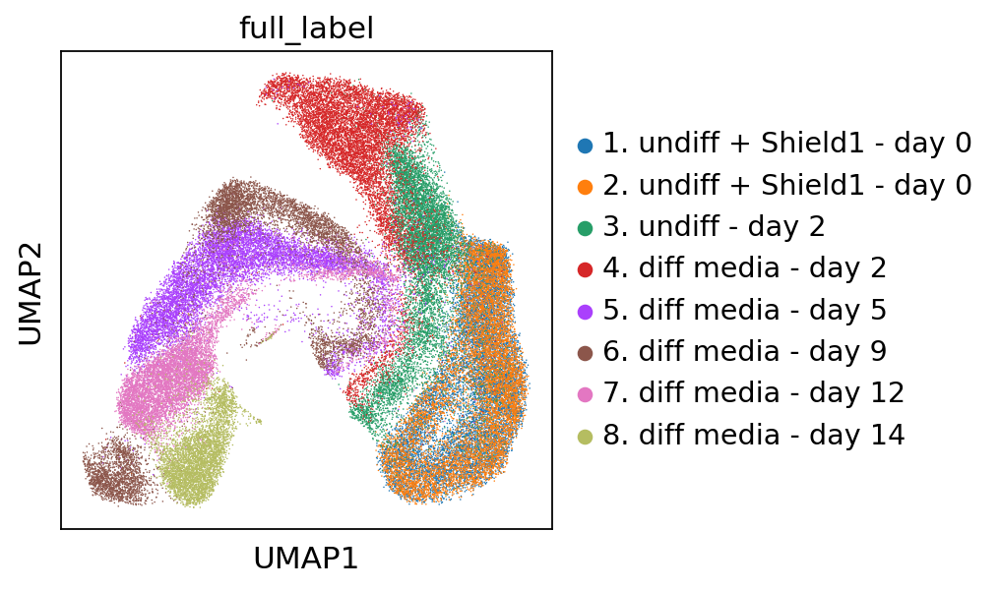

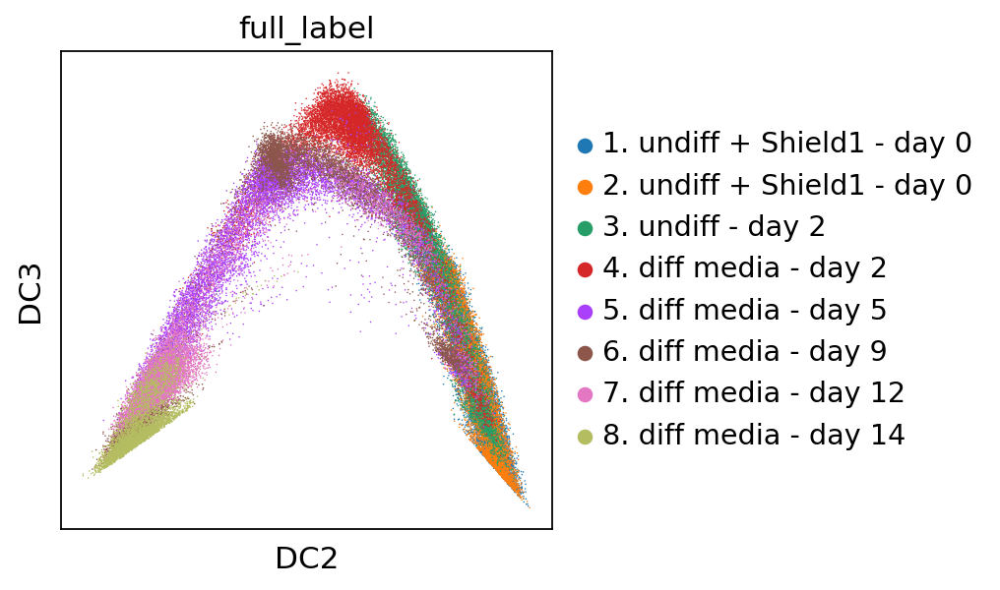

In [3]:
sc.pl.umap(adata, color='full_label', save="_sample.pdf")
sc.pl.diffmap(adata, color='full_label', dimensions=(1,2), save="_sample.pdf")

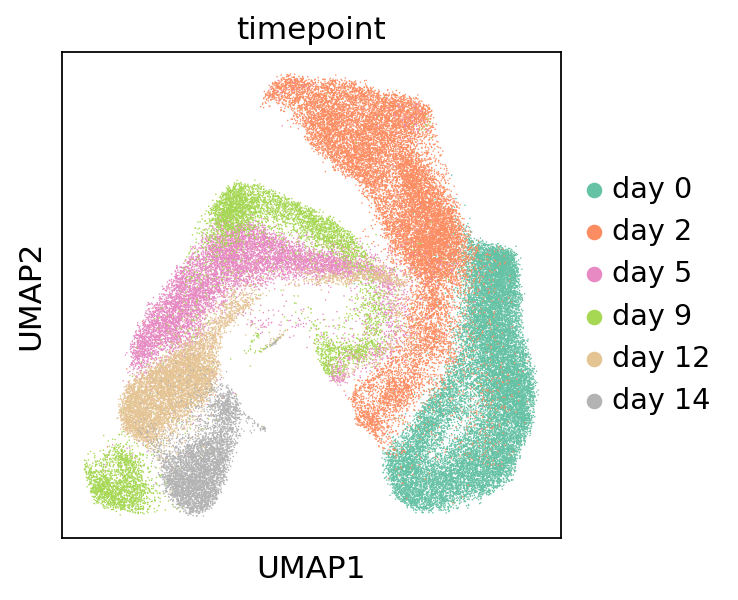

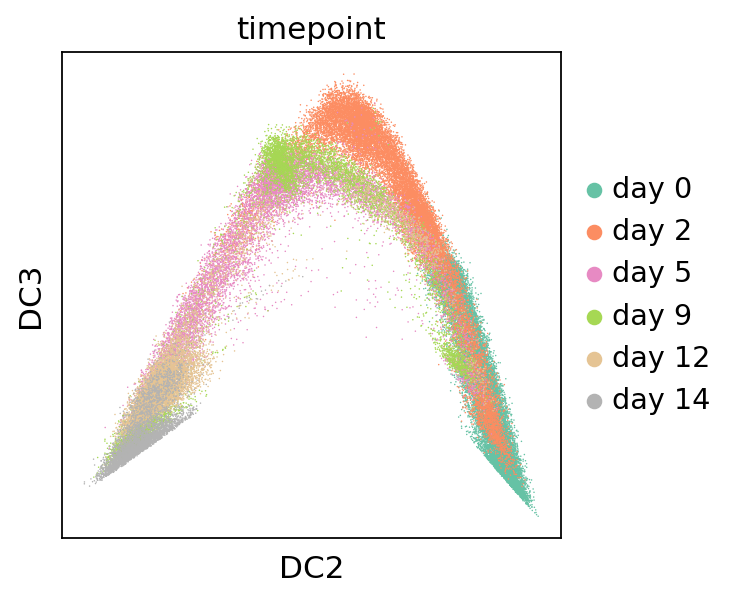

In [4]:
sc.pl.umap(adata, color='timepoint', palette="Set2", save="_timepoint.pdf")
sc.pl.diffmap(adata, color='timepoint', palette="Set2",dimensions=(1,2),  save="_timepoint.pdf")

# Cell cycle

In [5]:
cc_genes_file = './Macosko_cell_cycle_genes.txt'
#Score cell cycle and visualize the effect:
cc_genes = pd.read_table(cc_genes_file, delimiter='\t')
s_genes = cc_genes['S'].dropna()
g2m_genes = cc_genes['G2.M'].dropna()

sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes, use_raw=False)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    911 total control genes are used. (0:00:00)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    899 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)


... storing 'phase' as categorical


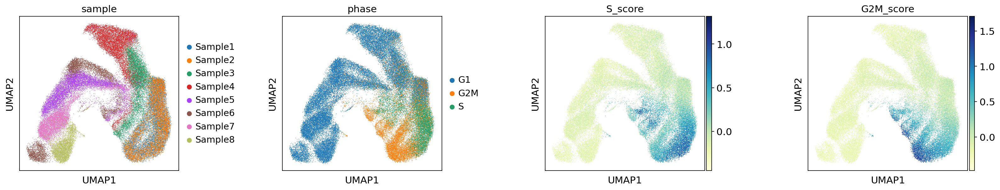

In [6]:

sc.pl.umap(adata, color=['sample', 'phase', 'S_score', 'G2M_score'], wspace=0.5, save="_cell_cycle.pdf")

phase,G1,G2M,S
sample,,,
Sample1,1347,5141,4471
Sample2,1235,3825,3782
Sample3,4268,2503,2105
Sample4,7463,858,818
Sample5,7980,709,632
Sample6,5466,640,563
Sample7,6787,191,260
Sample8,4476,36,31


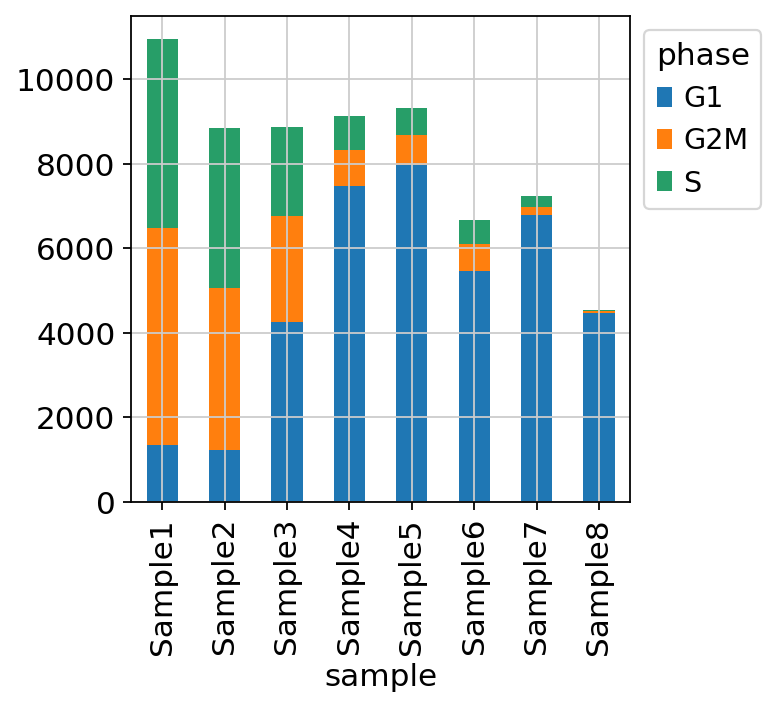

In [7]:

df = pd.crosstab(adata.obs['sample'], adata.obs['phase'])
ax = df.plot(kind='bar', stacked=True, color=adata.uns['phase_colors'])
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
plt.savefig('nb_cell_compo_cell_cycle.png', dpi=800, bbox_inches='tight')
df




In [8]:
scv.set_figure_params(style='scvelo', dpi=80, dpi_save=800,vector_friendly=True,
                     frameon=True)
plt.rcParams['figure.figsize']=(8,8)

saving figure to file ./figures/scvelo__cell_cycle.pdf


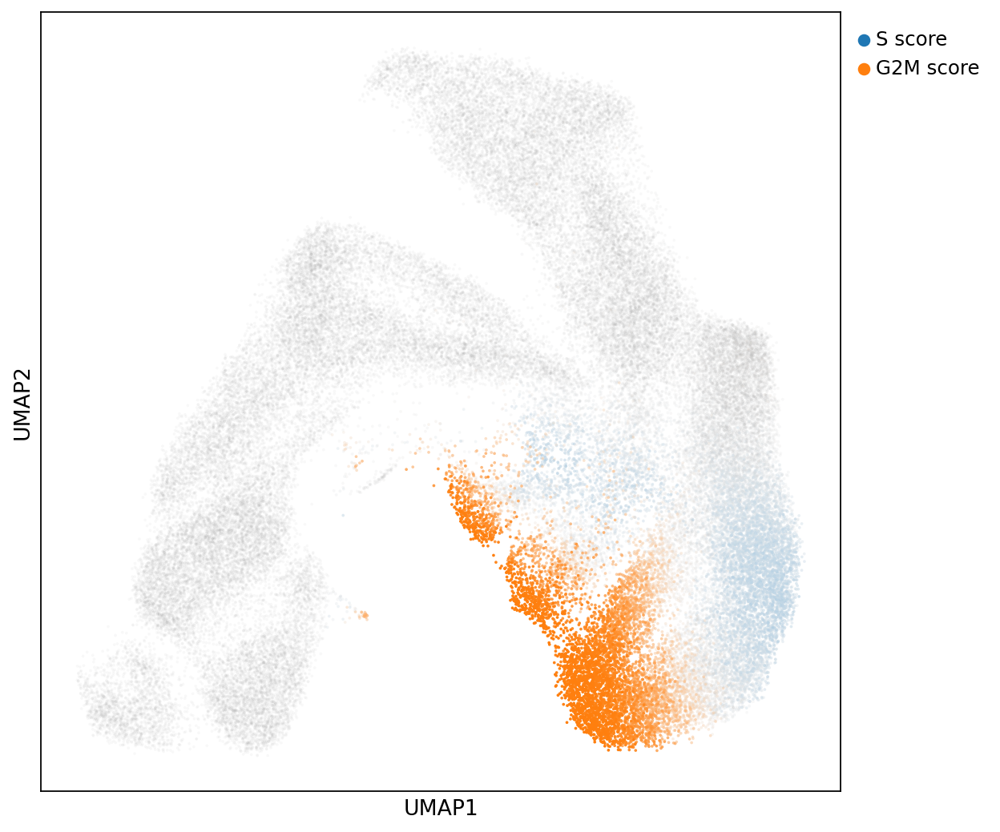

In [9]:
#scv.tl.score_genes_cell_cycle(adata)
f1 = scv.pl.scatter(adata, color_gradients=['S_score', 'G2M_score'], 
               smooth=True, perc=[5, 95], save='_cell_cycle.pdf', linewidth=0, show=True)


In [10]:
adata.uns['phase_colors'] = [ '#279e68','#ff7f0e', '#1f77b4']

In [11]:

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
# settings for the plots
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=800,
                     frameon=True, vector_friendly=True,
                     color_map="YlGnBu", format='pdf', transparent=False,
                     ipython_format='png2x')


phase,G1,G2M,S
sample,,,
Sample1,1347,5141,4471
Sample2,1235,3825,3782
Sample3,4268,2503,2105
Sample4,7463,858,818
Sample5,7980,709,632
Sample6,5466,640,563
Sample7,6787,191,260
Sample8,4476,36,31


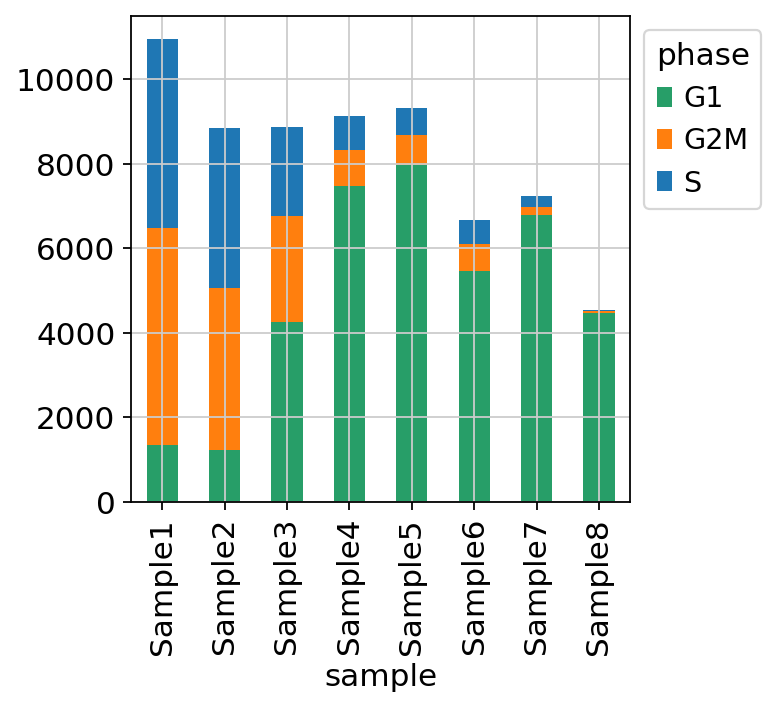

In [12]:

df = pd.crosstab(adata.obs['sample'], adata.obs['phase'])
ax = df.plot(kind='bar', stacked=True, color=adata.uns['phase_colors'])
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
plt.savefig('nb_cell_compo_cell_cycle.png', dpi=800, bbox_inches='tight')
df



phase,G1,G2M,S
sample,,,
Sample1,12.291267,46.911215,40.797518
Sample2,13.967428,43.259444,42.773128
Sample3,48.084723,28.199639,23.715638
Sample4,81.661013,9.388336,8.950651
Sample5,85.613132,7.606480,6.780388
Sample6,81.961314,9.596641,8.442045
Sample7,93.768997,2.638851,3.592153
Sample8,98.525204,0.792428,0.682368


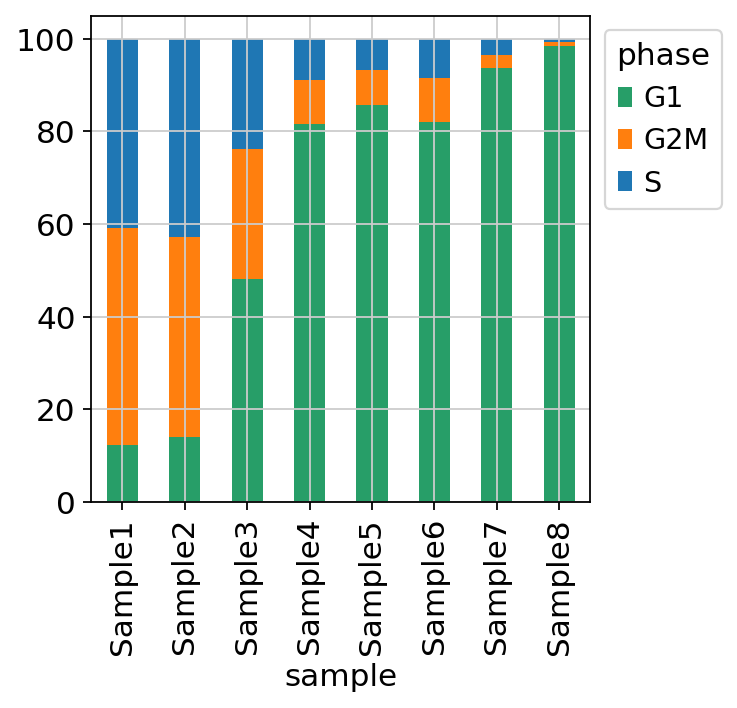

In [13]:
df = pd.crosstab(adata.obs['sample'], adata.obs['phase'])
for i in range(0, len(set(adata.obs['sample']))):
    df.iloc[i] = [x*100/sum(df.iloc[i].tolist()) for x in df.iloc[i].tolist()]
ax = df.plot(kind='bar', stacked=True, color=adata.uns['phase_colors'])
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
plt.savefig('pct_cell_compo_cell_cycle.png', dpi=800, bbox_inches='tight')
df

## Cell type 

In [14]:
adata

AnnData object with n_obs × n_vars = 65587 × 1880
    obs: 'sample', 'cell_barcode_sample', 'full_label', 'timepoint', 'doublet_score', 'predicted_doublet', 'n_counts', 'log_counts', 'n_genes', 'cellranger_n_counts', 'mt_frac', 'n_genes_by_counts', 'total_counts', 'leiden', 'S_score', 'G2M_score', 'phase', 'clusters_gradients'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'diffmap_evals', 'full_label_colors', 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'sample_colors', 'timepoint_colors', 'umap', 'phase_colors', 'clusters_gradients_colors'
    obsm: 'X_diffmap', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'ambiguous', 'matrix', 'raw_counts', 'spliced', 'unspliced'
    obsp: 'connectivities', 'distances'

In [15]:
adata2 = sc.read('tmp_processed_file2.h5ad')
adata2

AnnData object with n_obs × n_vars = 65587 × 1880
    obs: 'sample', 'cell_barcode_sample', 'full_label', 'timepoint', 'doublet_score', 'predicted_doublet', 'n_counts', 'log_counts', 'n_genes', 'cellranger_n_counts', 'mt_frac', 'n_genes_by_counts', 'total_counts', 'S_score', 'G2M_score', 'phase', 'leiden_celltype', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'majority_voting_low', 'predicted_labels_low', 'majority_voting_high', 'predicted_labels_high', 'dpt_pseudotime', 'leiden'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_sample', 'diffmap_evals', 'full_label_colors', 'hvg', 'iroot', 'leiden', 'leiden_celltype_colors', 'leiden_colors', 'log1p', 'majority_voting_high_colors', 'majority_voting_low_colors', 'neighbors', 'pca', 'phase_colors', 'predicted_labels_high_colors', '

In [16]:
for key in ['majority_voting_high', 'predicted_labels_high', 'conf_score']:
    adata.obs[key] = adata2.obs[key].copy()

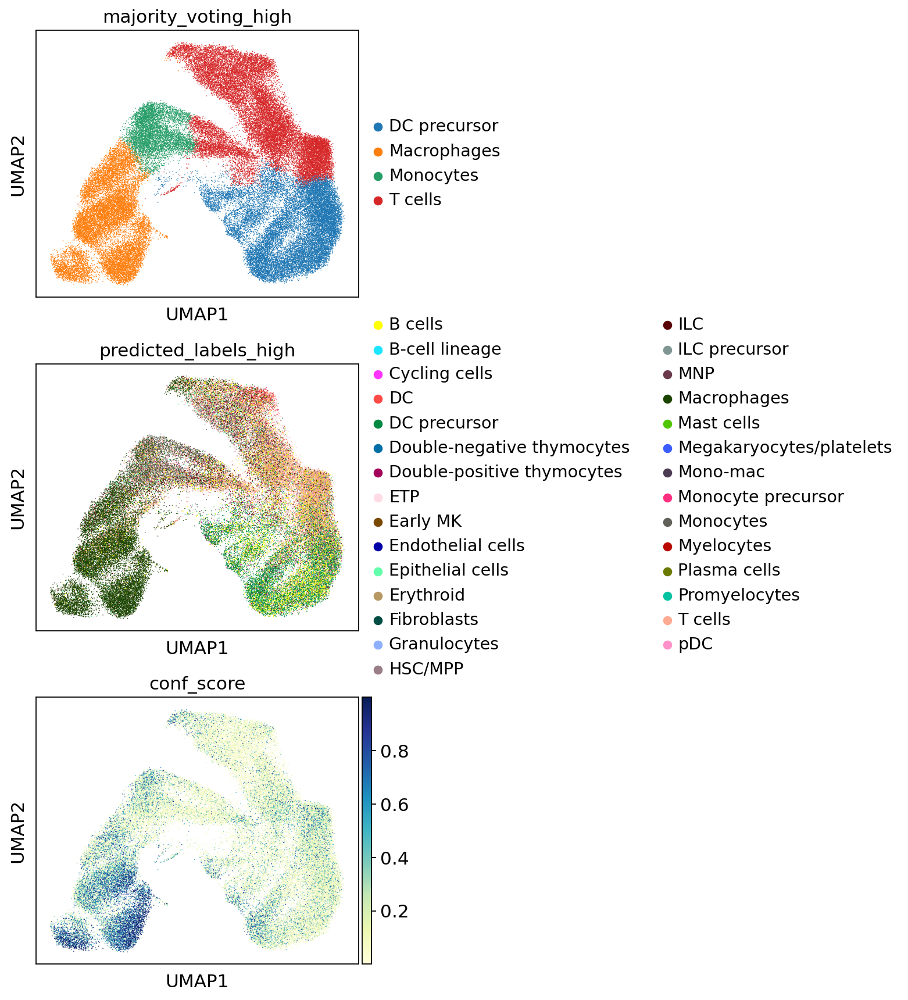

In [17]:
sc.pl.umap(adata, color=['majority_voting_high', 'predicted_labels_high', 'conf_score'], ncols=1)

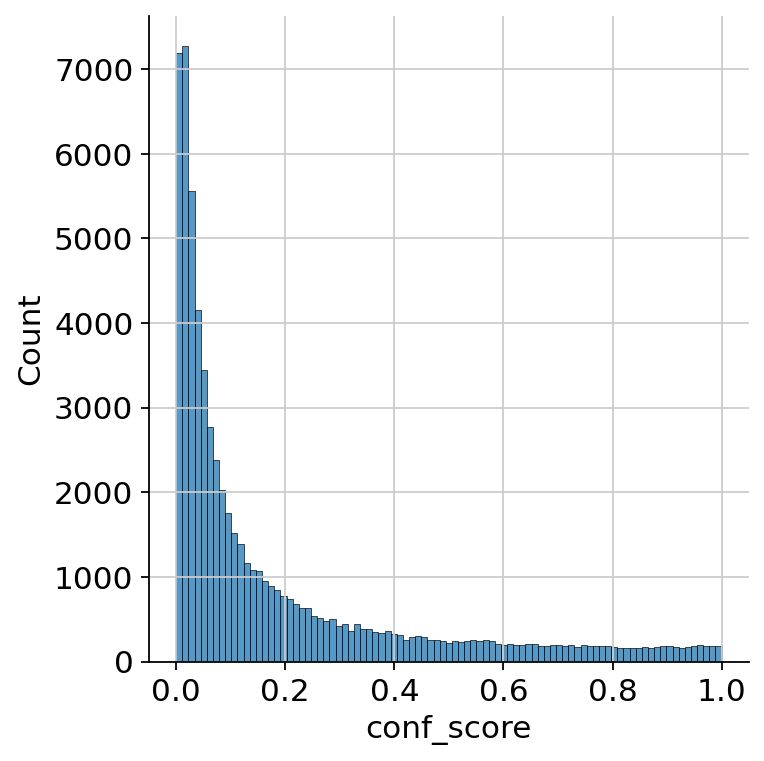

In [18]:
sns.displot(adata.obs['conf_score'])

... storing 'predicted_label_threshold_conf' as categorical


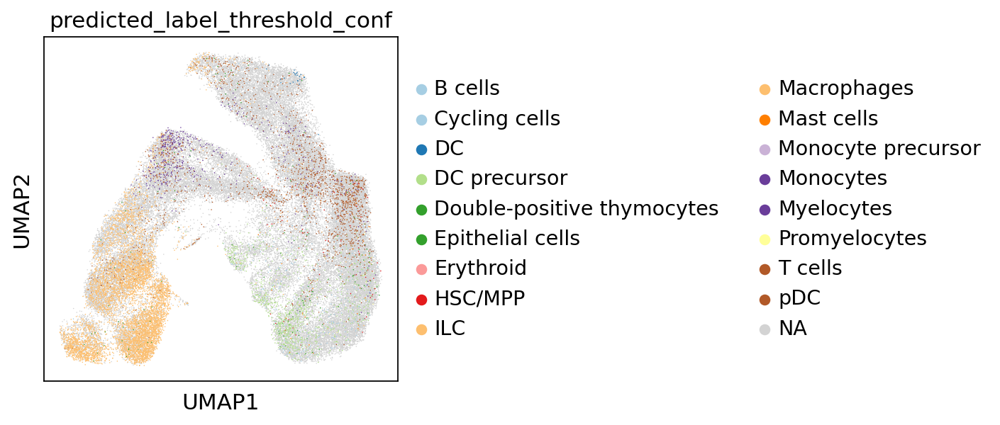

In [35]:
threshold = 0.4
label = []
index =0
for value in adata.obs['conf_score']:
    if value > threshold:
        label.append(adata.obs['predicted_labels_high'].tolist()[index])
    else:
        label.append(np.nan)
    index += 1
adata.obs['predicted_label_threshold_conf'] = label
sc.pl.umap(adata, color='predicted_label_threshold_conf', palette="Paired", save='_conf_threshold_cell_label.pdf')

In [37]:
len(adata.uns['predicted_label_threshold_conf_colors'])


17

In [38]:
adata.uns['predicted_label_threshold_conf_colors']

['#a6cee3',
 '#a6cee3',
 '#1f78b4',
 '#b2df8a',
 '#33a02c',
 '#33a02c',
 '#fb9a99',
 '#e31a1c',
 '#fdbf6f',
 '#fdbf6f',
 '#ff7f00',
 '#cab2d6',
 '#6a3d9a',
 '#6a3d9a',
 '#ffff99',
 '#b15928',
 '#b15928']

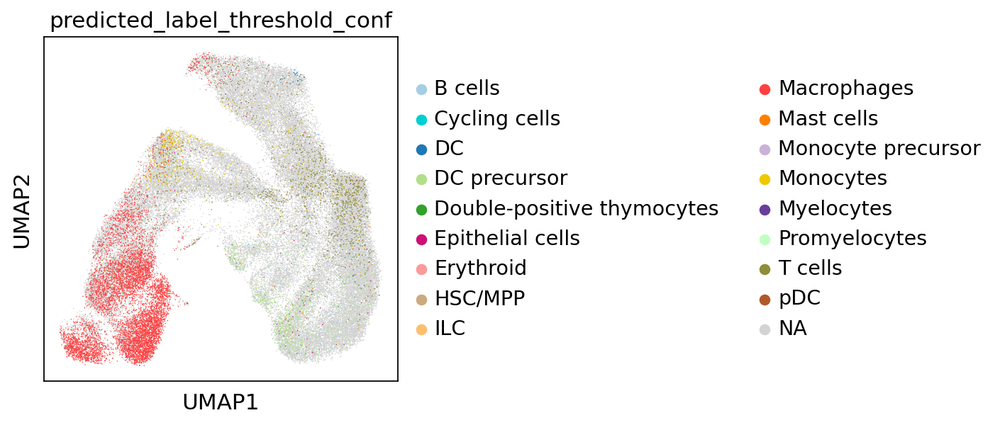

In [56]:
sc.pl.umap(adata, color='predicted_label_threshold_conf',
           palette=['#a6cee3',
 "#00CED1",#'#a6cee3',
 '#1f78b4',
 '#b2df8a',
 '#33a02c',
                    
    '#CD1076', #'#33a02c',
 '#fb9a99',
 '#CDAA7D',#'#e31a1c',
 '#fdbf6f',
     '#FF4040',#'#fdbf6f',
 '#ff7f00',
 '#cab2d6',
     '#EEC900', #'#6a3d9a',
 '#6a3d9a',
 '#C1FFC1', #'#ffff99',
 '#8E8E38', #'#b15928',
 '#b15928'], save='_conf_threshold_cell_label_new_palette.pdf')

ValueError: The following color value of the given palette is not valid: polychrome

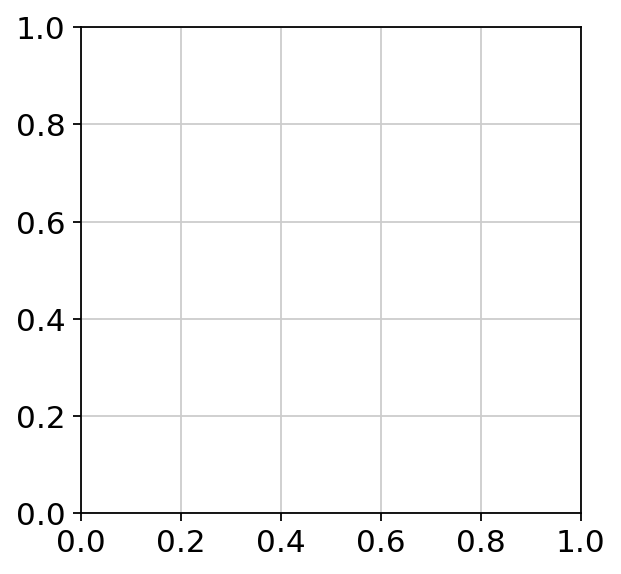

In [41]:
sc.pl.umap(adata, color='predicted_label_threshold_conf',
           palette=['polychrome'], save='_conf_threshold_cell_label_new_palette.pdf')

running Leiden clustering
    finished: found 46 clusters and added
    'leiden_celltype', the cluster labels (adata.obs, categorical) (0:00:16)


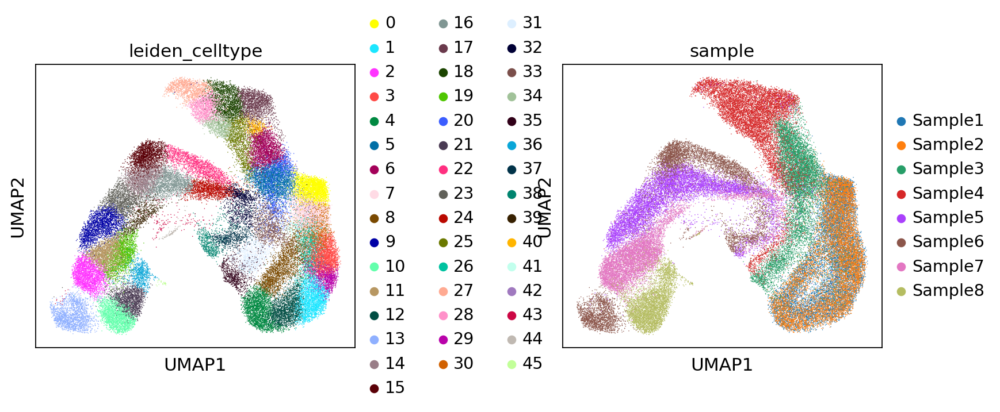

In [11]:
#models.download_models(force_update = True)
#models.models_description()
sc.tl.leiden(adata, resolution=5, key_added='leiden_celltype')
sc.pl.umap(adata, color=['leiden_celltype', 'sample'], wspace=0.5)

In [12]:
celltypist.annotate?

⚠️ Warning: invalid expression matrix, expect all genes and log1p normalized expression to 10000 counts per cell. The prediction result may not be accurate
🔬 Input data has 65587 cells and 1880 genes
🔗 Matching reference genes in the model
🧬 1092 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
🗳️ Majority voting the predictions
✅ Majority voting done!


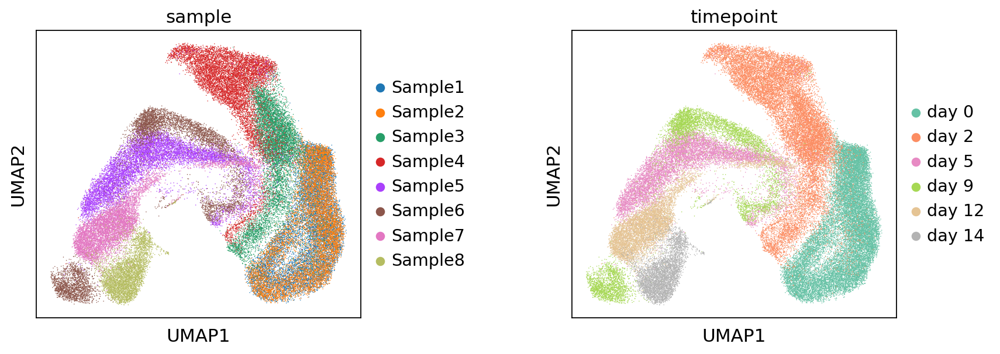

the obs value 'predicted_labels_high2' has more than 103 categories. Uniform 'grey' color will be used for all categories.


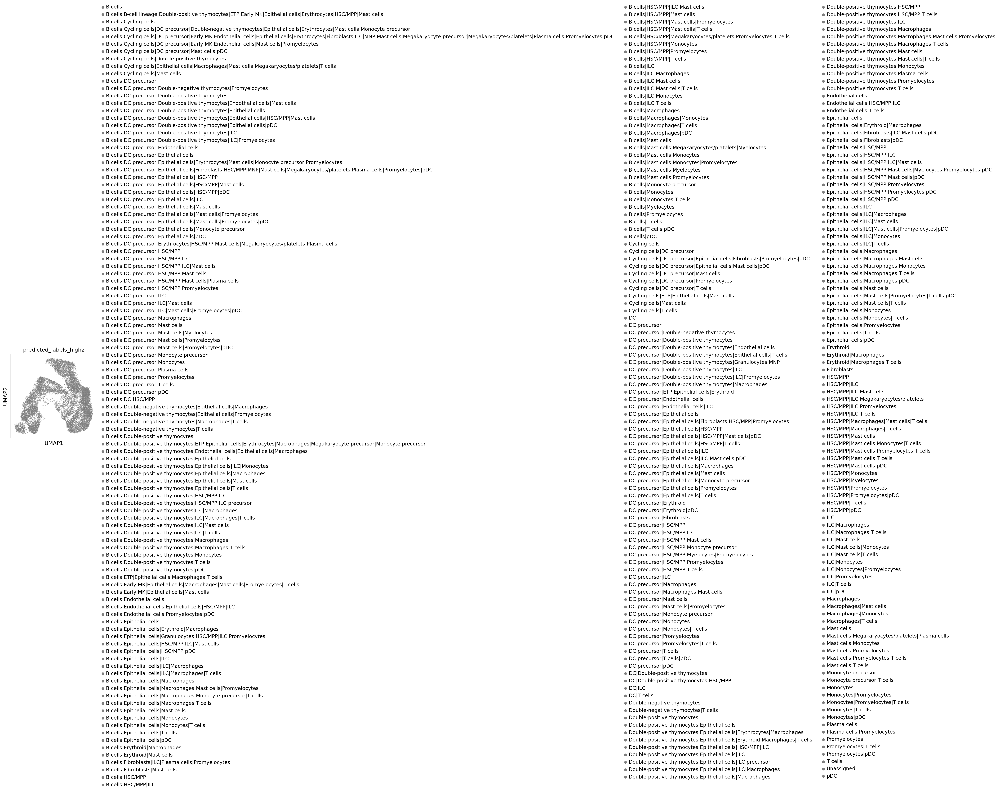

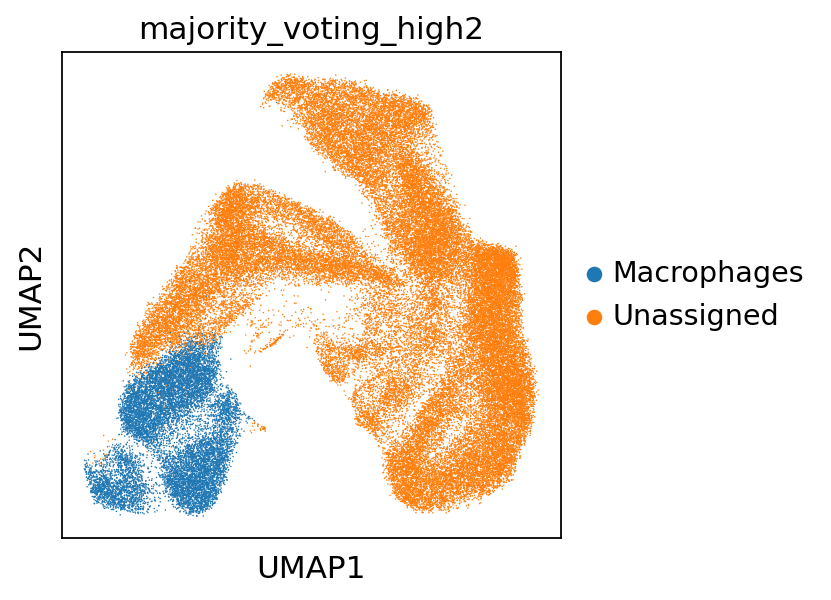

In [13]:
model = models.Model.load(model = 'Immune_All_High.pkl')
#model.cell_types
predictions = celltypist.annotate(adata, model = 'Immune_All_High.pkl',
                                  majority_voting = True,
                                  mode='prob match',
                                  p_thres=0.15,
                                  
                                  over_clustering='leiden_celltype')
# Get an `AnnData` with predicted labels embedded into the cell metadata columns.
adata = predictions.to_adata()

adata.obs['majority_voting_high2'] = adata.obs['majority_voting']
adata.obs['predicted_labels_high2'] = adata.obs['predicted_labels']
sc.pl.umap(adata, color=['sample', 'timepoint'], wspace=0.5, ncols=3)
sc.pl.umap(adata, color=['predicted_labels_high2'], wspace=0.5, ncols=3, save="predicted_label_high.pdf")
sc.pl.umap(adata, color=['majority_voting_high2'], wspace=0.5, ncols=3, save="majority_loving_label_high.pdf")

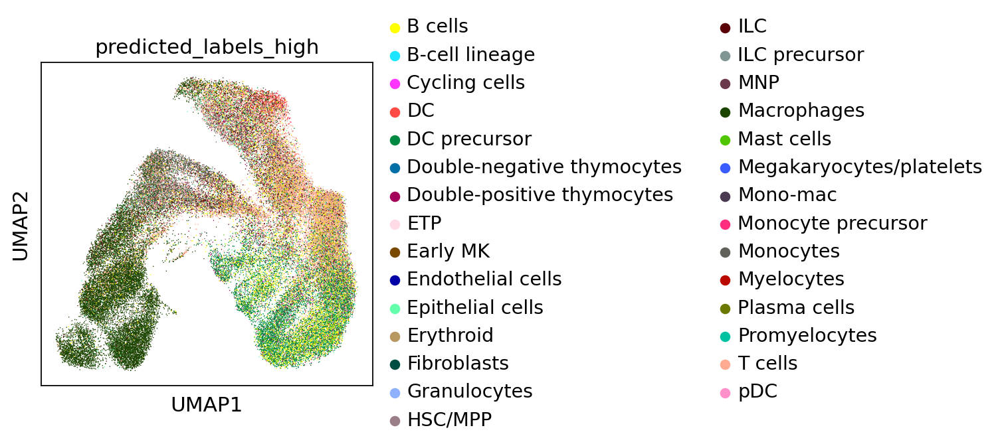

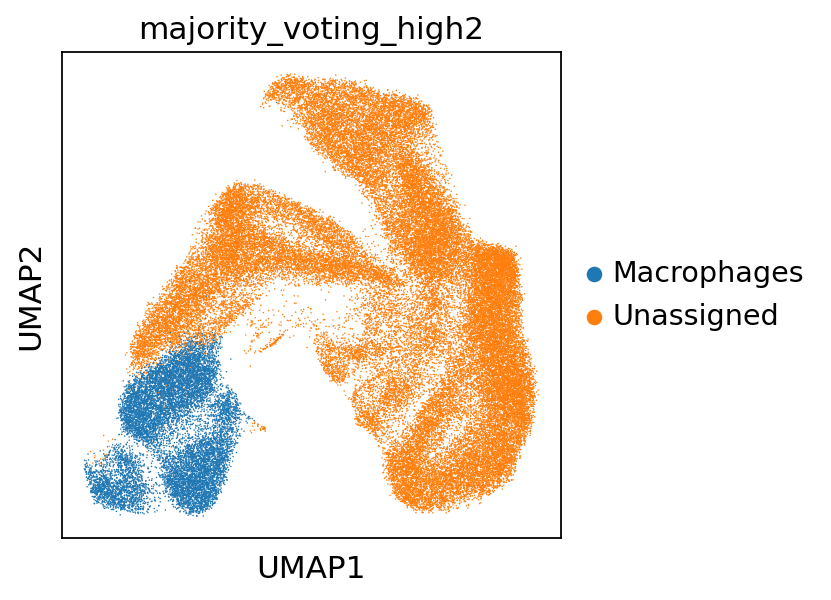

In [22]:
sc.pl.umap(adata, color=['predicted_labels_high'], wspace=0.5, ncols=3, save="predicted_label_high.pdf")

sc.pl.umap(adata, color=['majority_voting_high2'], wspace=0.5, ncols=3, save="high_conf_pred_label.pdf")

# Individual marker genes

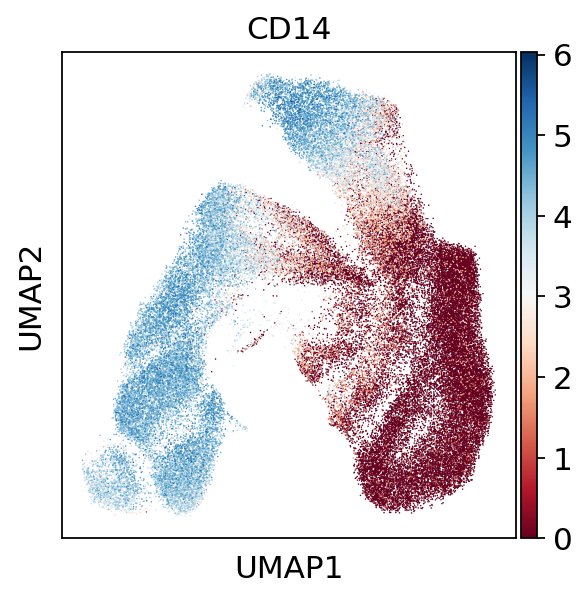

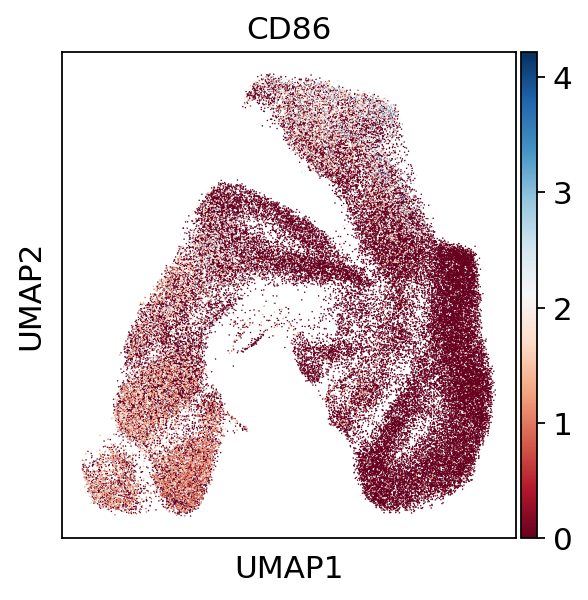

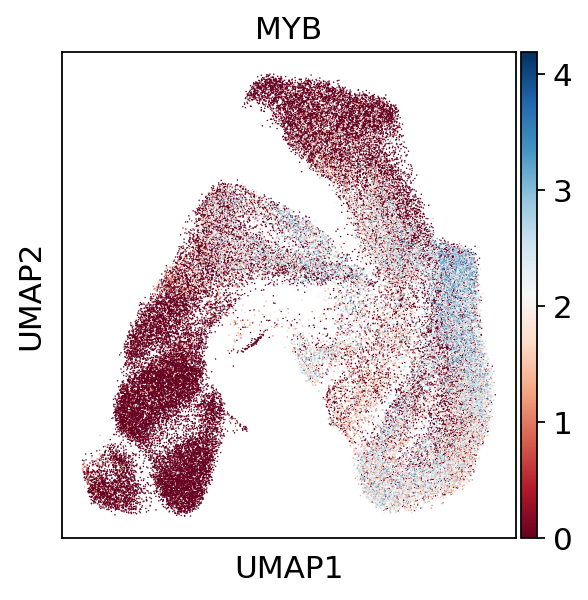

In [18]:
sc.pl.umap(adata, color='CD14', color_map="RdBu", save='_CD14.pdf')
sc.pl.umap(adata, color='CD86', color_map="RdBu", save='_CD86.pdf')
sc.pl.umap(adata, color='MYB', color_map="RdBu", save='_MYB.pdf')

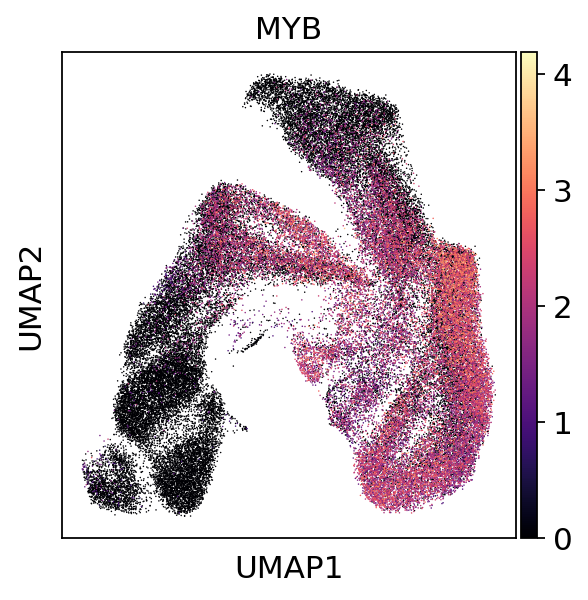

In [21]:
sc.pl.umap(adata, color='MYB', color_map="magma", save='_magma_MYB.pdf')

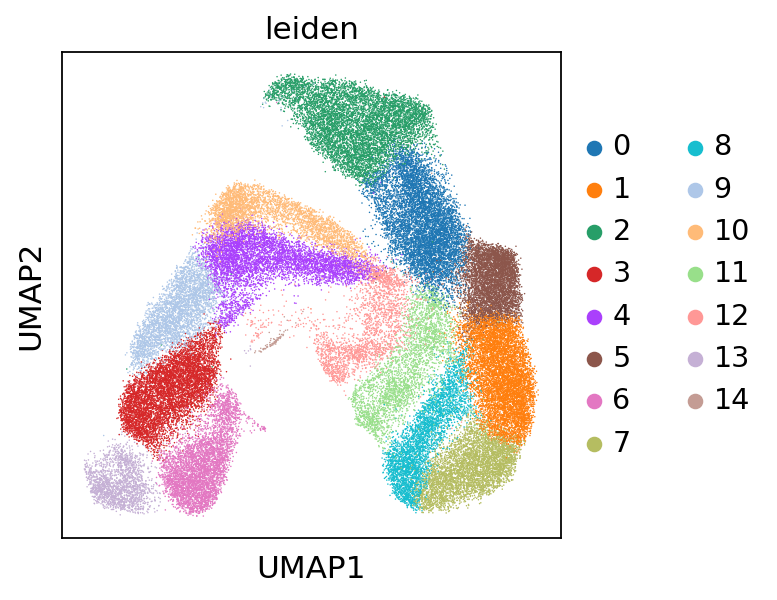

In [20]:
sc.pl.umap(adata, color='leiden')

Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


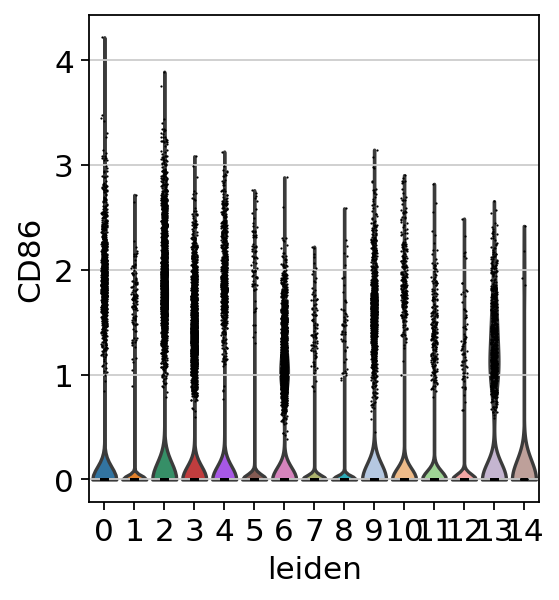

In [22]:
sc.pl.violin(adata, keys='CD86', groupby='leiden')

In [15]:
palette=[]

# Gene score 

In [16]:
MLL_AML_markers = ['Adcy9', 'Apoc2', 'Apoc4', 'BC028528', 'Bmi1', 'Bre', 'Cacna2d4', 'Cadm1', 'Camk1', 'Cd4',
                   'Cd70', 'Cd74', 'Ces1g', 'Chchd10', 'Chd3', 'Col9a2', 'Cpm', 'Cpne8', 'Dach1', 'Ereg', 'Fbp1',
                   'Fcgr1', 'Fez1', 'Foxc1', 'Gpm6b', 'Hnmt', 'Hoxa10', 'Hoxa11', 'Hoxa3', 'Hoxa4', 'Hoxa5',
                   'Hoxa7', 'Hoxa9', 'Hspb1', 'Itgax', 'Lamp5', 'Lat2', 'Lcat', 'Meis1', 'Mettl7b', 'Nid1',
                   'Nipa1', 'Parvg', 'Pbx3', 'Pcdh9', 'Pqlc2', 'Pycard', 'Rab27b', 'Rbks', 'Reep3', 'Rnase6',
                   'Rpp25', 'Samhd1', 'Sdc2', 'Sel1l3', 'Skida1', 'Smyd3', 'Socs2', 'Spint1', 'Syt17', 'Trpm4',
                   'Ubxn11', 'Zfp503', 'Zfp521']

macrophage_markers =['MT1G', 'ADAMDEC1', 'CD14', 'MT1A', 'MMP9', 'MT1F', 'TPT1', 'FTL', 'EEF1A1', 'MT1H',
                     'FTHL7', 'TMSB4X', 'IL8', 'HLA-A', 'LAIR1', 'MT2A', 'CEBPB', 'IMAA', 'ITGB2', 'CXCL16',
                     'GNS', 'SRGN', 'C19orf31', 'MRPS6', 'CD44', 'NCOA4', 'FARSLB', 'F2R', 'CTSH', 'OAZ1',
                     'UBC', 'LOC91561', 'CCL5', 'ECGF1', 'LOC388720', 'SAT1', 'LYZ', 'HLA-DRA', 'RPS27',
                     'RPS29', 'ITIH5', 'LILRB3', 'RPL41', 'CTSB', 'ARHGDIB', 'RPS27A', 'CTSL1']


macrophage_markers2 =['MT1G', 'ADAMDEC1', 'CD14', 'MT1A', 'MMP9', 'MT1F', 'TPT1', 'FTL', 'EEF1A1', 'MT1H',
                     'TMSB4X', 'HLA-A', 'LAIR1', 'MT2A', 'CEBPB', 'ITGB2', 'CXCL16',
                     'GNS', 'SRGN', 'MRPS6', 'CD44', 'NCOA4', 'F2R', 'CTSH', 'OAZ1',
                     'UBC', 'CCL5', 'SAT1', 'LYZ', 'HLA-DRA', 'RPS27',
                     'RPS29', 'ITIH5', 'LILRB3', 'RPL41', 'CTSB', 'ARHGDIB', 'RPS27A',]

missing_markers = ['C19orf31', 'CTSL1', 'ECGF1', 'FARSLB', 'FTHL7', 'IL8', 'IMAA', 'LOC388720', 'LOC91561']



computing score 'macrophage_score'
    finished: added
    'macrophage_score', score of gene set (adata.obs).
    349 total control genes are used. (0:00:02)


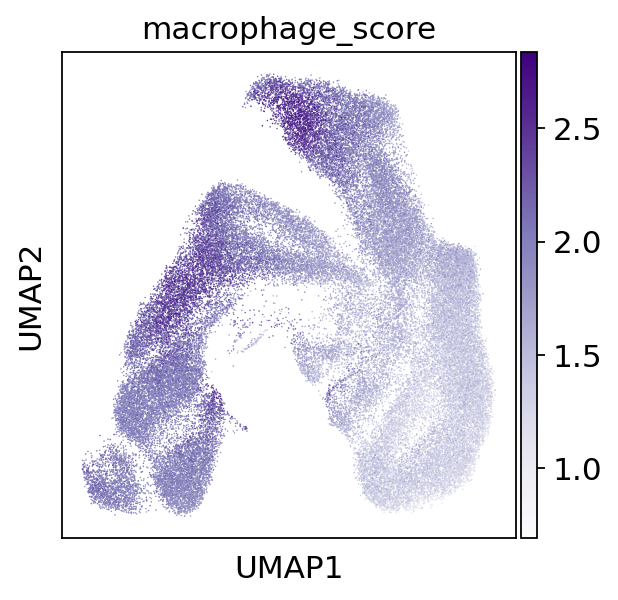

In [17]:
sc.tl.score_genes(adata, gene_list=macrophage_markers2, score_name='macrophage_score')
sc.pl.umap(adata,color=[ 'macrophage_score'], wspace=0.5, color_map='Purples', save="_macrophage_marker_scores.pdf")

# Celltypist markers

In [18]:
model = models.Model.load(model = 'Immune_All_High.pkl')

In [19]:

top_genes_macrophages = model.extract_top_markers('Macrophages', 15)
top_genes_macrophages

array(['AC026369.3', 'GNLY', 'LPL', 'PAQR5', 'PCOLCE2', 'GLDN', 'SELENOP',
       'FTL', 'CD5L', 'PAGE4', 'FTH1', 'APOE', 'C1QA', 'LINC02154',
       'CXCL5'], dtype=object)

computing score 'macrophage_score_celltypist'
    finished: added
    'macrophage_score_celltypist', score of gene set (adata.obs).
    351 total control genes are used. (0:00:01)


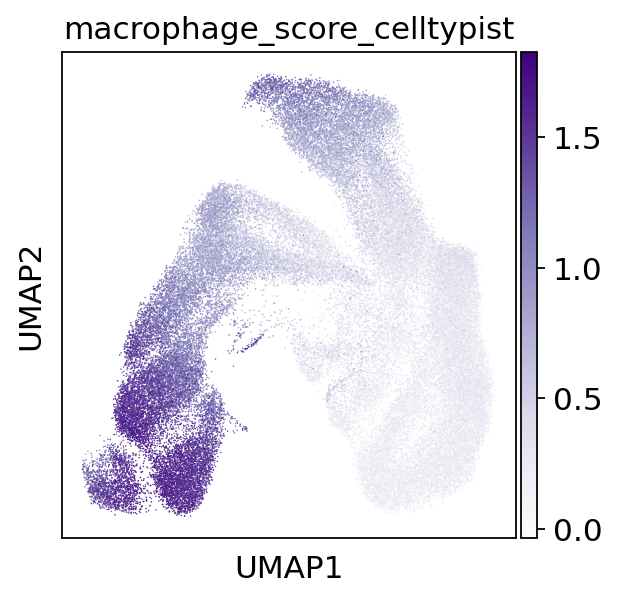

In [20]:
sc.tl.score_genes(adata, gene_list=top_genes_macrophages, score_name='macrophage_score_celltypist')
sc.pl.umap(adata,color=['macrophage_score_celltypist'], wspace=0.5, color_map='Purples', save="_macrophage_celltypist_scores.pdf")

In [21]:
'Accent', 'Accent_r', 'Blues', 'Blues_r', 'BrBG', 'BrBG_r', 'BuGn', 'BuGn_r', 'BuPu', 'BuPu_r', 
'CMRmap', 'CMRmap_r', 'Dark2', 'Dark2_r', 'GnBu', 'GnBu_r', 'Greens', 'Greens_r', 'Greys', 'Greys_r', 
'OrRd', 'OrRd_r', 'Oranges', 'Oranges_r', 'PRGn', 'PRGn_r', 'Paired', 'Paired_r', 'Pastel1', 'Pastel1_r',
'Pastel2', 'Pastel2_r', 'PiYG', 'PiYG_r', 'PuBu', 'PuBuGn', 'PuBuGn_r', 'PuBu_r', 'PuOr', 'PuOr_r', 'PuRd', 
'PuRd_r', 'Purples', 'Purples_r', 'RdBu', 'RdBu_r', 'RdGy', 'RdGy_r', 'RdPu', 'RdPu_r', 'RdYlBu', 'RdYlBu_r',
'RdYlGn', 'RdYlGn_r', 'Reds', 'Reds_r', 'Set1', 'Set1_r', 'Set2', 'Set2_r', 'Set3', 'Set3_r', 'Spectral',
'Spectral_r', 'Wistia', 'Wistia_r', 'YlGn', 'YlGnBu', 'YlGnBu_r', 'YlGn_r', 'YlOrBr', 
'YlOrBr_r', 'YlOrRd', 'YlOrRd_r', 'afmhot', 'afmhot_r', 
'autumn', 'autumn_r', 'binary', 'binary_r', 'bone',
'bone_r', 'brg', 'brg_r', 'bwr', 'bwr_r', 'cividis', 
'cividis_r', 'cool', 'cool_r', 'coolwarm', 'coolwarm_r', 
'copper', 'copper_r', 'crest', 'crest_r', 'cubehelix', 'cubehelix_r', 
'flag', 'flag_r', 'flare', 'flare_r', 'gist_earth', 'gist_earth_r', 
'gist_gray', 'gist_gray_r', 'gist_heat', 'gist_heat_r', 'gist_ncar', 
'gist_ncar_r', 'gist_rainbow', 'gist_rainbow_r', 'gist_stern', 'gist_stern_r', 
'gist_yarg', 'gist_yarg_r', 'gnuplot', 'gnuplot2', 'gnuplot2_r', 'gnuplot_r', 'gray', 
'gray_r', 'hot', 'hot_r', 'hsv', 'hsv_r', 'icefire', 'icefire_r', 'inferno', 'inferno_r', 
'jet', 'jet_r', 'magma', 'magma_r', 'mako', 'mako_r', 'nipy_spectral', 'nipy_spectral_r', 
'ocean', 'ocean_r', 'pink', 'pink_r', 'plasma', 'plasma_r', 'prism', 'prism_r', 'rainbow', 
'rainbow_r', 'rocket', 'rocket_r', 'seismic', 'seismic_r', 'spring', 'spring_r', 'summer', 
'summer_r', 'tab10', 'tab10_r', 'tab20', 'tab20_r', 'tab20b', 'tab20b_r', 'tab20c', 'tab20c_r',
'terrain', 'terrain_r', 'turbo', 'turbo_r', 'twilight', 'twilight_r', 'twilight_shifted', 
'twilight_shifted_r', 'viridis', 'viridis_r', 'vlag',
'vlag_r', 'winter', 'winter_r'

('vlag_r', 'winter', 'winter_r')

# Unitvelo plot 

In [92]:
adata = scv.read('processed_file_post_unitvelo.h5ad')
adata

AnnData object with n_obs × n_vars = 65587 × 1328
    obs: 'sample', 'cell_barcode_sample', 'full_label', 'timepoint', 'doublet_score', 'predicted_doublet', 'n_counts', 'log_counts', 'n_genes', 'cellranger_n_counts', 'mt_frac', 'n_genes_by_counts', 'total_counts', 'leiden', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'velocity_self_transition', 'root_cells', 'end_points', 'velocity_pseudotime', 'latent_time'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'velocity_gamma', 'velocity_r2', 'scaling', 'velocity_genes', 'fit_vars', 'fit_varu', 'fit_gamma', 'fit_beta', 'fit_offset', 'fit_a', 'fit_t', 'fit_h', 'fit_intercept', 'fit_loss', 'fit_llf', 'fit_sr2', 'fit_ur2'
    uns: 'base_function', 'basis', 'datapath', 'diffmap_evals', 'full_label_colors', 'hvg', 'label', 'leiden', 'leiden_colors', 'log1p', 'lo

computing latent time using root_cells as prior
    finished (0:01:26) --> added 
    'latent_time', shared time (adata.obs)
saving figure to file ./figures/scvelo__unitvelo_latent_time.pdf


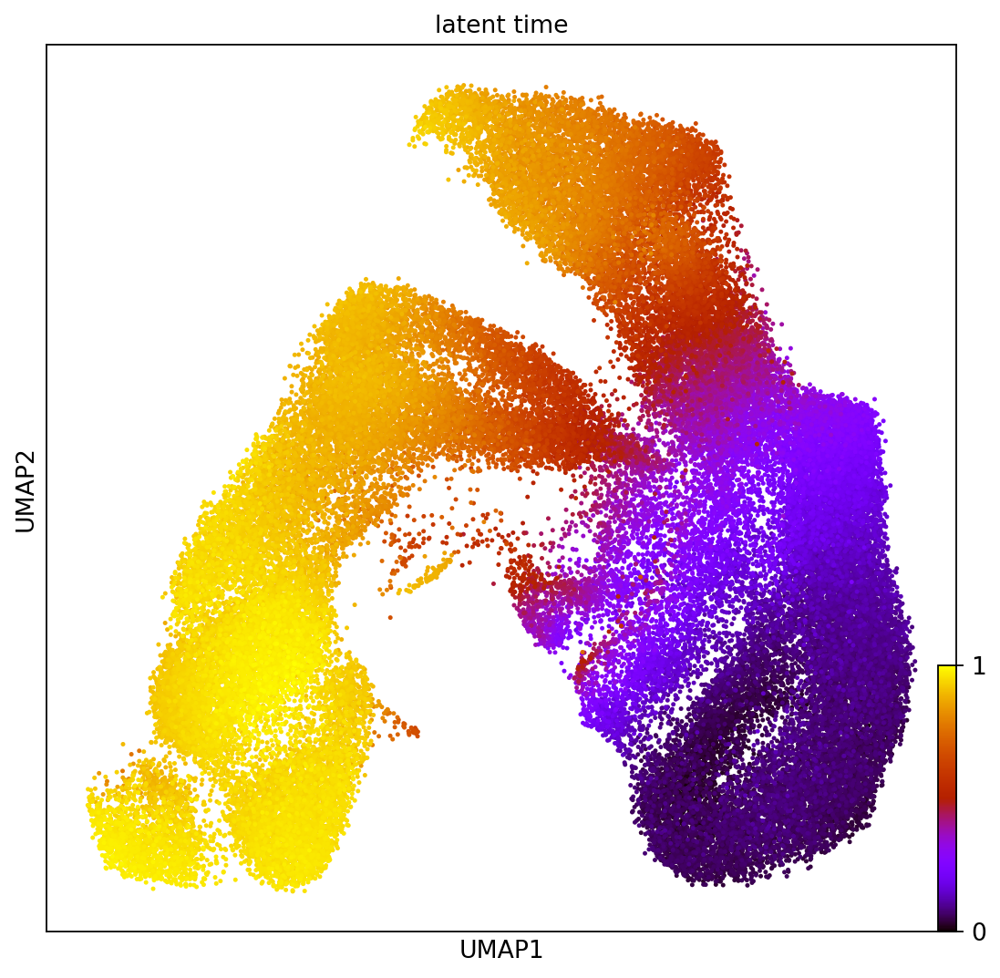

In [93]:
scv.tl.latent_time(adata, min_likelihood=None)
scv.pl.scatter(adata, color='latent_time', color_map='gnuplot', size=20, save="_unitvelo_latent_time.pdf")

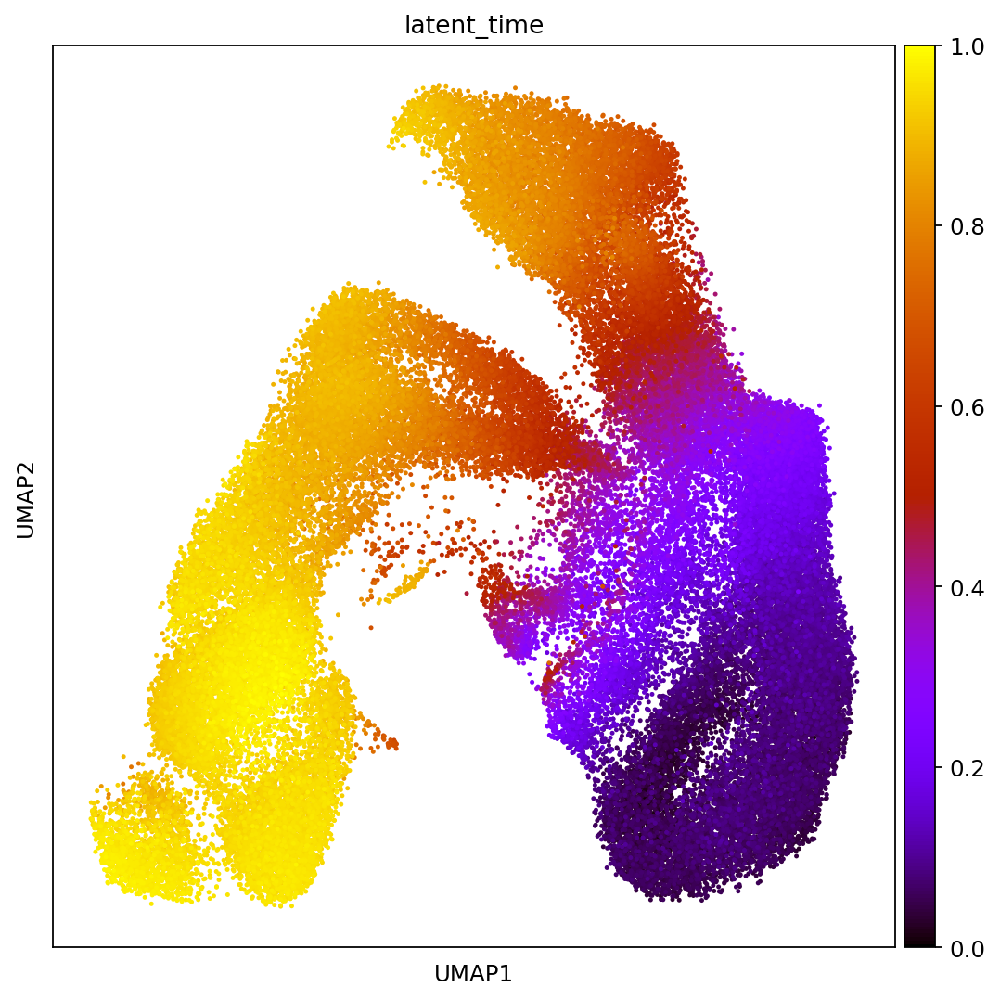

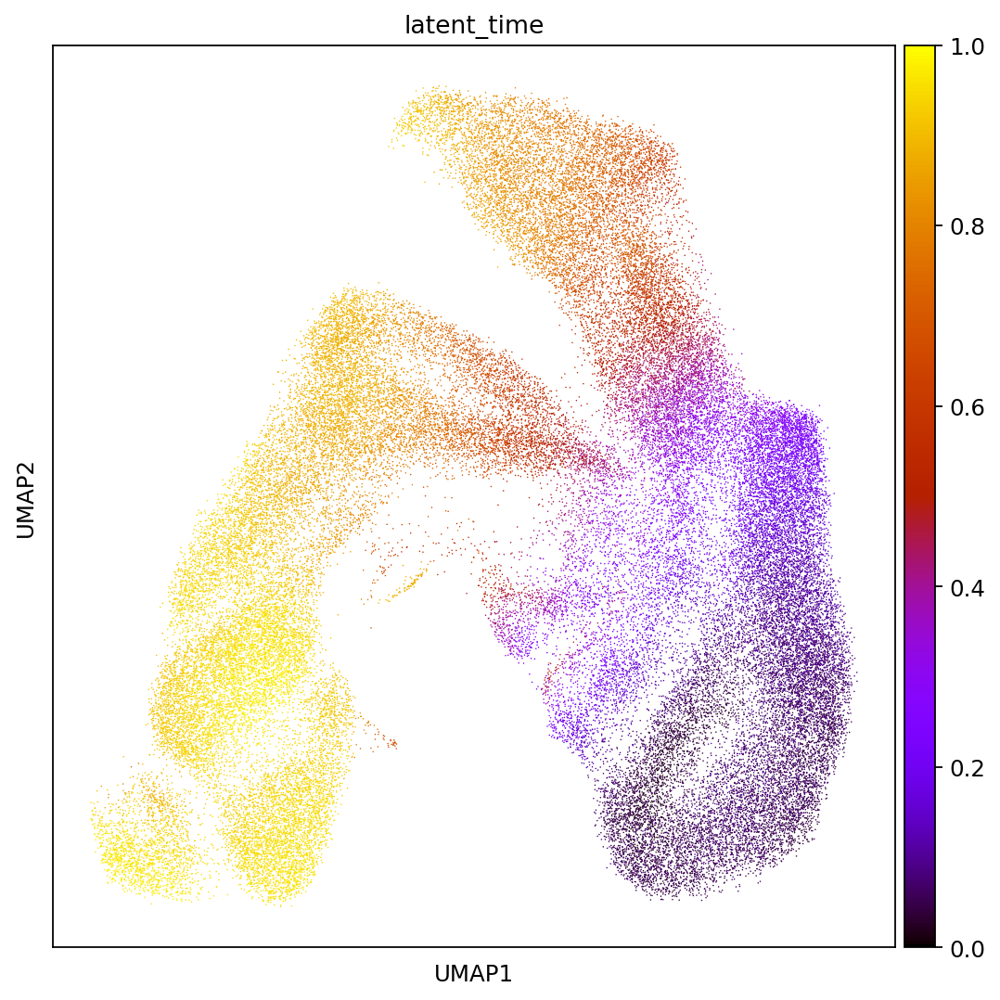

In [99]:
sc.pl.umap(adata, color='latent_time', color_map='gnuplot',size=20, save="_unitvelo_latent_time.pdf")
sc.pl.umap(adata, color='latent_time', color_map='gnuplot', save="_unitvelo_latent_time-2.pdf")

In [95]:
scv.pl.scatter?

ranking velocity genes
    finished (0:00:31) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)
saving figure to file ./figures/scvelo_heatmap__unitvelo_velocity_markers_pre_sample.pdf


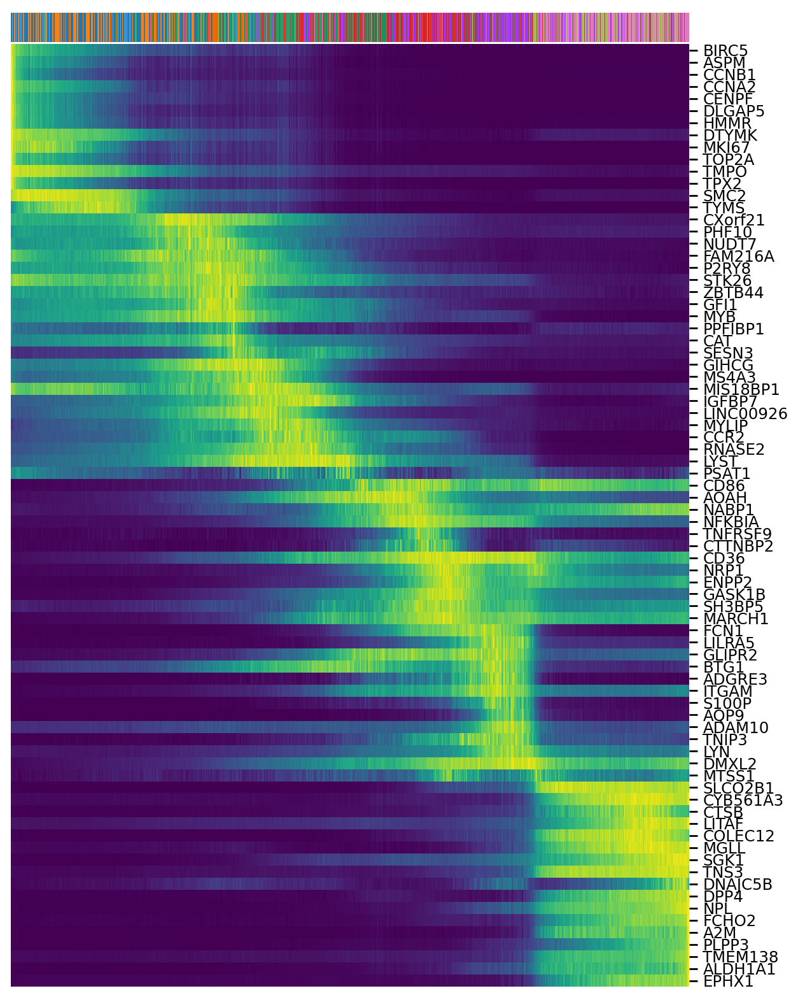

In [94]:
scv.tl.rank_velocity_genes(adata, groupby='sample', min_corr=.3)

df = scv.DataFrame(adata.uns['rank_velocity_genes']['names'])
df.head()

gene = []
for columns in df.columns.tolist():
    gene += df[columns].tolist()[0:15]
    
gene = list(set(gene))
scv.pl.heatmap(
    adata, var_names=gene, sortby='latent_time', yticklabels=True,
    col_color='sample', n_convolve=100,figsize=(8, 10),font_scale=1, save="_unitvelo_velocity_markers_pre_sample.pdf")

saving figure to file ./figures/scvelo_heatmap__unitvelo_velocity_markers_pre_sample.png


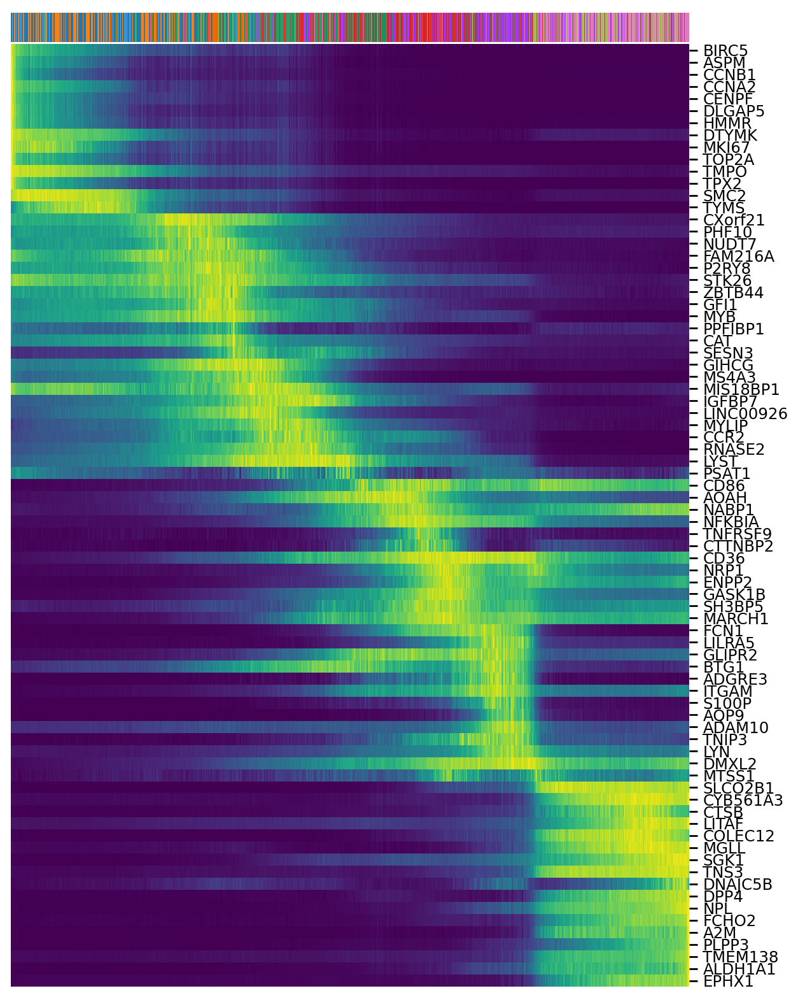

In [100]:
scv.pl.heatmap(
    adata, var_names=gene, sortby='latent_time', yticklabels=True,
    col_color='sample', n_convolve=100,figsize=(8, 10),font_scale=1, save="_unitvelo_velocity_markers_pre_sample.png")

In [20]:
sc.__version__

'1.9.3'